#**RCNN and Yolo**


1. What is the main purpose of RCNN in object detection?


The main purpose of **R-CNN** (Region-based Convolutional Neural Networks) in object detection is to improve the accuracy and efficiency of detecting objects within an image. It achieves this by combining the power of Convolutional Neural Networks (CNNs) with region proposals, which allows the model to focus on potential object locations and classify them.

Here's how it works in a simplified way:

1. **Region Proposal**: First, the algorithm generates a set of candidate regions (also called region proposals) in the image that may contain objects. This is typically done using methods like Selective Search.
  
2. **Feature Extraction**: These candidate regions are then passed through a pre-trained CNN (usually a model like AlexNet or VGG) to extract features from each region.

3. **Classification**: The extracted features are used to classify each region into a specific object class (or background).

4. **Bounding Box Refinement**: Finally, for each detected object, R-CNN refines the bounding box to make sure it tightly fits around the object.

R-CNN significantly improves object detection accuracy compared to earlier methods by leveraging deep learning, but it can be slow due to the separate processing of each region. This was addressed in later models like Fast R-CNN and Faster R-CNN, which optimize the pipeline for better speed and performance.

In summary, **R-CNN's main purpose** is to detect objects within an image by first proposing candidate regions and then classifying those regions using deep convolutional features.

2. What is the difference between Fast RCNN and Faster RCNN?


The main difference between **Fast R-CNN** and **Faster R-CNN** lies in the method they use for generating region proposals, which are critical for object detection tasks.

### 1. **Fast R-CNN**:
- **Region Proposal Generation**: In Fast R-CNN, region proposals are generated **externally** using a separate algorithm like **Selective Search** or other region proposal algorithms. These methods scan the image to identify potential regions that could contain objects.
- **Object Detection**: After generating region proposals, the Fast R-CNN network then processes each proposal by warping it into a fixed size, extracting features from the shared convolutional layers (using a **CNN**), and classifying each proposal into object categories.
  
  **Key Points:**
  - Fast R-CNN is faster than its predecessor R-CNN (Region-based CNN), but still uses external region proposal methods.
  - The CNN is applied to the whole image to produce feature maps, and each proposal is then classified based on the feature map.
  
### 2. **Faster R-CNN**:
- **Region Proposal Generation**: Faster R-CNN improves upon Fast R-CNN by integrating **Region Proposal Networks (RPN)** directly into the network. The RPN generates region proposals by sliding a small network over the feature map of the image to predict object bounds (bounding boxes) and scores (objectness). This eliminates the need for external methods like Selective Search, making it much faster.
- **End-to-End Training**: Faster R-CNN allows for end-to-end training of both the object detection network and the RPN, enabling faster and more efficient training and inference compared to Fast R-CNN.

  **Key Points:**
  - Faster R-CNN has an integrated Region Proposal Network (RPN), removing the need for external region proposal algorithms.
  - It enables **end-to-end** training, where both the RPN and object detection parts are trained together.
  - It significantly reduces computation time by eliminating the need for selective search, improving speed and performance.

### Summary of Key Differences:
| **Aspect**                | **Fast R-CNN**                                      | **Faster R-CNN**                                   |
|---------------------------|-----------------------------------------------------|----------------------------------------------------|
| **Region Proposal Method** | Uses external algorithms (like Selective Search)   | Uses Region Proposal Network (RPN) integrated into the model |
| **Training**               | Two-stage: External proposals + CNN training       | End-to-end training (RPN + object detection)       |
| **Speed**                  | Faster than R-CNN, but slower than Faster R-CNN    | Faster due to integrated RPN and end-to-end training |
| **Efficiency**             | Less efficient due to reliance on external proposal generation | More efficient due to shared feature map and no need for external proposals |

In summary, **Faster R-CNN** improves upon **Fast R-CNN** by replacing the external region proposal generation with a faster, integrated Region Proposal Network (RPN), making it significantly faster and more efficient in object detection tasks.

3. How does YOLO handle object detection in real-time?


YOLO (You Only Look Once) is a real-time object detection system that processes images extremely fast. Here's how it works:

1. **Single Pass Detection**: Unlike traditional methods that apply models at multiple locations and scales, YOLO uses a single neural network to predict bounding boxes and class probabilities directly from the full image in one evaluation. This makes it very fast.

2. **Dividing the Image**: The network divides the image into regions and predicts bounding boxes and probabilities for each region. These bounding boxes are weighted by the predicted probabilities.

3. **Global Context**: Since YOLO looks at the whole image at test time, its predictions are informed by the global context in the image.

4. **Speed and Efficiency**: YOLO is significantly faster than other detection systems like R-CNN, which require thousands of network evaluations for a single image. YOLO can process images at 45 frames per second (fps) with its base model and even faster with smaller versions.

5. **End-to-End Optimization**: The entire detection pipeline is a single network, which can be optimized end-to-end directly on detection performance.


4. Explain the concept of Region Proposal Networks (RPN) in Faster RCNN.


Region Proposal Networks (RPN) are a critical component of Faster R-CNN, which is a faster and more efficient version of the traditional R-CNN model for object detection. Here’s how RPNs work and their role in Faster R-CNN:

1. **Region Proposals**: The RPN generates a set of region proposals. These proposals are essentially possible bounding boxes where an object might be located. The idea is to narrow down the regions that the model needs to consider for detecting objects.

2. **Anchor Boxes**: RPN uses anchor boxes of different scales and aspect ratios to predict possible bounding boxes. Anchor boxes are predefined fixed shapes that act as reference points to help predict the locations and sizes of objects.

3. **Sliding Window Approach**: The network slides a small window over the feature map generated by a convolutional neural network (CNN). At each window location, it generates several region proposals using the anchor boxes.

4. **Score and Refine Proposals**: For each proposal, the RPN predicts two things:
   - The probability that the proposal contains an object (objectness score).
   - The bounding box coordinates, which refine the anchor box to better fit the object.

5. **Shared Computation**: A major advantage of RPNs in Faster R-CNN is the sharing of computation between the region proposal generation and the object detection. Both processes use the same underlying convolutional feature map, which makes the system faster.

6. **Integration with Fast R-CNN**: The region proposals generated by the RPN are fed into the Fast R-CNN network, which classifies the objects within these regions and further refines their bounding boxes.

In essence, the RPN component of Faster R-CNN makes it efficient by quickly generating high-quality region proposals and integrating them seamlessly into the object detection pipeline.

5. How does YOLOV9 improve upon its predecessors?


YOLOv9 represents a significant leap forward in the evolution of the YOLO (You Only Look Once) object detection models, building on the successes and limitations of its predecessors, particularly YOLOv8. Here are the key improvements and innovations introduced with YOLOv9:

## Architectural Innovations

**1. Programmable Gradient Information (PGI):**
   - PGI addresses the vanishing gradient problem commonly encountered in deep neural networks. It incorporates an auxiliary reversible branch that generates reliable gradients without increasing inference costs, thereby improving training efficiency and model accuracy.

**2. Generalized Efficient Layer Aggregation Network (GELAN):**
   - GELAN enhances multi-scale feature aggregation while minimizing computational overhead. This architecture allows for better feature extraction and fusion, which is crucial for accurate object detection across various scales.

## Performance Enhancements

**1. Reduction in Parameters and Computation:**
   - YOLOv9 achieves a **49% reduction in parameters** and a **43% reduction in computational requirements** compared to YOLOv8, making it more efficient for deployment on resource-constrained devices.

**2. Improved Accuracy:**
   - The model demonstrates a **0.6% improvement in mean Average Precision (mAP)** over YOLOv8 when evaluated on the MS COCO dataset, achieving an accuracy of **93.6%**. This improvement is particularly important for complex detection tasks.

## Versatility and Deployment

**1. Multiple Variants:**
   - YOLOv9 is available in four variants (v9-S, v9-M, v9-C, v9-E), each tailored for different computational environments and performance needs, providing flexibility for various applications from edge devices to high-performance GPUs.

**2. Integration with Frameworks:**
   - The model supports seamless integration with popular frameworks like PyTorch and TensorRT, facilitating ease of deployment across diverse applications in real-time object detection.

## Summary of Benefits

- **Higher Efficiency:** The combination of PGI and GELAN not only enhances accuracy but also ensures that YOLOv9 operates efficiently, suitable for real-time applications.
- **Scalability:** The different model variants allow users to select the best fit for their specific hardware capabilities and application requirements.
- **User-Friendly:** With its open-source nature and availability on platforms like GitHub, YOLOv9 is accessible for developers looking to implement advanced object detection solutions quickly.

In conclusion, YOLOv9 sets a new benchmark in the field of real-time object detection by significantly improving upon its predecessors through innovative architectural designs and enhanced performance metrics.


6. What role does non-max suppression play in YOLO object detection?


Non-max suppression (NMS) is a crucial step in the YOLO object detection pipeline. Its primary role is to eliminate redundant or overlapping bounding boxes and ensure that each object is detected only once. Here’s how it works and why it’s essential:

1. **Duplicate Predictions**: YOLO can generate multiple bounding boxes around the same object, especially when it's trying to be thorough. This leads to multiple overlapping detections for a single object.

2. **Selecting the Best Bounding Box**: NMS selects the best bounding box for each object based on the highest predicted probability (confidence score). It does this by keeping the box with the highest score and discarding the rest.

3. **IoU Thresholding**: NMS uses a metric called Intersection over Union (IoU) to measure the overlap between bounding boxes. It keeps the bounding box with the highest confidence score and removes any other boxes that have an IoU greater than a certain threshold (usually 0.5). This helps in reducing the number of false positives.

4. **Reducing Redundancy**: By eliminating redundant detections, NMS ensures that the final output is cleaner and more accurate, with each object being represented by a single bounding box.

5. **Performance Optimization**: Applying NMS helps in maintaining the balance between precision and recall, ensuring that the model is both accurate and efficient in real-time detection scenarios.

To summarize, non-max suppression refines YOLO's output by removing duplicate detections and retaining only the most relevant bounding boxes, enhancing both the accuracy and efficiency of object detection.

7. Describe the data preparation process for training YOLOV9.


## Data Preparation Process for YOLOv9

1. **Data Collection**: Gather a diverse set of images relevant to your object detection task.

2. **Data Annotation**: Label the images with bounding boxes and class information in the YOLO format (e.g., `<object-class> <x_center> <y_center> <width> <height>`).

3. **Annotation Format Conversion**: Ensure all annotations are in the correct YOLO format, with separate `.txt` files for each image.

4. **Dataset Splitting**: Divide the dataset into training, validation, and test sets (commonly 70%/15%/15%).

5. **Organizing Dataset Structure**: Create a structured directory layout for images and labels:
   ```
   /data
     ├── /images
     │    ├── train
     │    ├── val
     │    └── test
     └── /labels
          ├── train
          ├── val
          └── test
   ```

6. **Data Augmentation (Optional)**: Apply techniques like flipping or rotation to enhance the training dataset.

7. **Finalizing Configuration**: Create a `data.yaml` file specifying paths to images and annotations for training.


8. What is the significance of anchor boxes in object detection models like YOLOV9?


Anchor boxes are critical components in object detection models like YOLOv9, serving several important functions:

### **1. Predefined References**
Anchor boxes are predefined bounding boxes that help the model predict the locations and sizes of objects more accurately.

### **2. Multiple Predictions**
They enable the model to make multiple predictions at each location in the image, allowing for the detection of various objects simultaneously.

### **3. IoU Evaluation**
Anchor boxes facilitate the measurement of Intersection over Union (IoU), helping the model learn to refine its predictions based on how well these boxes overlap with actual objects.

### **4. Scale Handling**
By using a variety of anchor box sizes and aspect ratios, YOLOv9 can effectively detect objects of different scales within the same image.

### **5. Training Efficiency**
They streamline the detection process, reducing the need for exhaustive search methods and enhancing training efficiency.

### **6. Customization**
Users can customize anchor boxes based on specific datasets, improving detection performance for specialized applications.

In summary, anchor boxes enhance accuracy, efficiency, and adaptability in object detection tasks, making them essential for models like YOLOv9.

9. What is the key difference between YOLO and R-CNN architectures?


YOLO (You Only Look Once) and R-CNN (Regions with Convolutional Neural Networks) are both popular object detection architectures, but they have fundamental differences in how they detect objects. Here's a summary of their key differences:

1. **Detection Approach**:
   - **YOLO**: YOLO treats object detection as a single regression problem. It divides the image into a grid and directly predicts bounding boxes and class probabilities for each grid cell in one evaluation. This makes YOLO incredibly fast.
   - **R-CNN**: R-CNN first generates region proposals (potential bounding boxes where objects might be) and then classifies each proposal using a convolutional neural network. This two-stage process makes R-CNN slower compared to YOLO.

2. **Speed**:
   - **YOLO**: YOLO is designed for real-time object detection and can process images at 45 frames per second (fps) or more with its smaller models.
   - **R-CNN**: R-CNN is significantly slower, requiring multiple steps including region proposal, feature extraction, and classification, which can take several seconds per image.

3. **Complexity**:
   - **YOLO**: YOLO is less complex in terms of architecture and easier to implement. It uses a single neural network to perform detection and classification simultaneously.
   - **R-CNN**: R-CNN is more complex, involving separate stages for region proposal (Selective Search), feature extraction, and classification. This requires training multiple models and combining their outputs.

4. **Accuracy**:
   - **YOLO**: YOLO is known for its speed, but it may sacrifice some accuracy, especially when detecting smaller objects or objects that are close together.
   - **R-CNN**: R-CNN tends to be more accurate because it focuses on fewer region proposals and applies a more detailed analysis, but this comes at the cost of speed.

5. **Use Cases**:
   - **YOLO**: Ideal for applications where speed is crucial, such as real-time video processing, autonomous driving, and live surveillance.
   - **R-CNN**: Suitable for applications where accuracy is more important than speed, such as detailed image analysis, medical imaging, and scenarios where detection time is less critical.

In summary, YOLO excels in speed and simplicity, making it suitable for real-time applications, while R-CNN offers higher accuracy at the expense of speed and complexity, making it better for applications where precision is paramount.

10. Why is Faster RCNN considered faster than Fast RCNN?


Faster R-CNN is considered faster than Fast R-CNN primarily due to the introduction of the Region Proposal Network (RPN) and the integration of the proposal generation and object detection stages. Here are the key reasons:

1. **Region Proposal Network (RPN)**: In Fast R-CNN, the region proposals are generated using an external algorithm like Selective Search, which is computationally expensive and slow. Faster R-CNN replaces this with the RPN, which is a small neural network that generates region proposals more efficiently by sharing convolutional features with the detection network.

2. **Shared Convolutional Features**: Faster R-CNN uses a single convolutional neural network to generate both region proposals and detect objects. This sharing of features reduces the computational overhead significantly compared to Fast R-CNN, where the convolutional features are computed separately for each region proposal.

3. **End-to-End Training**: Faster R-CNN can be trained end-to-end, meaning the entire network, including the RPN and the object detector, is trained simultaneously. This streamlined training process further enhances efficiency and speed.

4. **Integrated Pipeline**: By integrating the proposal generation and object detection into a single, unified framework, Faster R-CNN eliminates the need for multiple stages of computation, which was necessary in Fast R-CNN. This integration simplifies the pipeline and improves overall speed.

In summary, the key innovation in Faster R-CNN is the Region Proposal Network, which allows for fast and efficient generation of region proposals by leveraging shared features. This, combined with end-to-end training and an integrated pipeline, makes Faster R-CNN significantly faster than its predecessor, Fast R-CNN.


11. What is the role of selective search in RCNN?


Selective Search is a crucial component in the original R-CNN (Regions with Convolutional Neural Networks) architecture. Its primary role is to generate a set of region proposals, which are potential bounding boxes where objects might be located within an image. Here’s how it functions:

1. **Region Proposal Generation**: Selective Search starts by generating potential object locations through an algorithm that merges superpixels based on various similarity measures. This generates around 2,000 region proposals for each image, which significantly reduces the number of regions that the network needs to analyze.

2. **Superpixel Segmentation**: The algorithm begins by segmenting the image into many small regions called superpixels, which are groups of pixels with similar colors or textures.

3. **Hierarchical Grouping**: These superpixels are then merged based on criteria like color similarity, texture similarity, size, and shape compatibility. The algorithm merges regions iteratively to form larger candidate regions.

4. **Quality and Speed Trade-off**: While Selective Search effectively reduces the number of regions that need to be processed, it is computationally intensive and relatively slow compared to other modern methods like Region Proposal Networks (RPNs) used in Faster R-CNN.

5. **Bounding Box Proposals**: The final output of Selective Search is a set of bounding box proposals, which are then fed into the convolutional neural network (CNN) for further processing to classify objects and refine the bounding boxes.

In essence, Selective Search helps to pinpoint the areas of the image that are most likely to contain objects, thus focusing the computational resources of the CNN on these regions and making the object detection process more efficient.


12. How does YOLOV9 handle multiple classes in object detection?


YOLOv9 effectively handles multiple classes in object detection through the following key features:

1. **Single-Pass Detection**: Processes the entire image in one go, identifying and classifying multiple objects simultaneously.

2. **Grid-Based Prediction**: Divides the image into a grid where each cell predicts bounding boxes and class probabilities for objects within its area.

3. **Class Probability Predictions**: Computes likelihood scores for each class associated with predicted bounding boxes, enhancing classification accuracy.

4. **Programmable Gradient Information (PGI)**: Improves learning outcomes by optimizing gradient management during training, especially with diverse classes.

5. **Generalized Efficient Layer Aggregation Network (GELAN)**: Enhances performance and feature extraction, crucial for detecting overlapping objects.

6. **Custom Training**: Allows users to train on specific datasets with varied classes, adapting the model to different applications.

These features collectively enable YOLOv9 to deliver high accuracy and efficiency in multi-class object detection tasks.

13. What are the key differences between YOLOV3 and YOLOV9?


## Key Differences Between YOLOv3 and YOLOv9 (In Short)

### **1. Architecture**
- **YOLOv3**: Utilizes Darknet-53 with 53 convolutional layers.
- **YOLOv9**: Introduces Generalized Efficient Layer Aggregation Network (GELAN) and Programmable Gradient Information (PGI) for improved efficiency and gradient propagation.

### **2. Performance**
- **YOLOv3**: Improved mean average precision (mAP) over YOLOv2, especially for small objects.
- **YOLOv9**: Surpasses YOLOv3 with a reported mAP increase of 0.6% on MS COCO and reduced parameters by 49%.

### **3. Flexibility**
- **YOLOv3**: Fixed architecture, less adaptable to various deployment scenarios.
- **YOLOv9**: Modular design allows customization based on specific application needs.

### **4. Computational Efficiency**
- **YOLOv3**: Approximately 45 frames per second (FPS) for real-time detection.
- **YOLOv9**: Achieves faster inference speeds while maintaining high accuracy.

### **5. Advanced Features**
- **YOLOv3**: Introduced independent logistic classifiers and anchor-based bounding box predictions.
- **YOLOv9**: Incorporates anchor-free detection and mosaic data augmentation for enhanced robustness.

In summary, YOLOv9 offers significant advancements in architecture, performance, flexibility, efficiency, and features compared to YOLOv3.

14. How is the loss function calculated in Faster RCNN?


In Faster R-CNN, the loss function integrates classification and regression losses to optimize both object detection and localization. Here's how it's computed:

1. **Region Proposal Network (RPN) Loss**:
   - **Classification Loss**: This loss measures how well the RPN classifies region proposals into object and non-object categories. It's typically a binary cross-entropy loss.
   - **Regression Loss**: This loss evaluates the accuracy of the bounding box predictions made by the RPN. It's often a smooth L1 loss, which helps in refining the bounding box coordinates.

   The total RPN loss is the sum of the classification and regression losses for the region proposals.

2. **Fast R-CNN Loss**:
   - **Classification Loss**: This part of the loss function calculates the discrepancy between the predicted and actual class probabilities for objects within the proposals, using a softmax cross-entropy loss.
   - **Regression Loss**: This loss assesses the precision of the bounding box refinements for the detected objects, using a smooth L1 loss.

   The total Fast R-CNN loss combines the classification and regression losses.

3. **Combined Loss**: The overall loss for Faster R-CNN is a weighted sum of the RPN loss and the Fast R-CNN loss. This comprehensive loss function ensures that both the region proposals and the final object detections are optimized effectively.

The mathematical expression for the loss function is:

$$L(\{p_i\}, \{t_i\}) = \frac{1}{N_{cls}} \sum_i L_{cls}(p_i, p_i^*) + \lambda \frac{1}{N_{reg}} \sum_i p_i^* L_{reg}(t_i, t_i^*)$$

Where:
- \( L_{cls} \) represents the classification loss.
- \( L_{reg} \) stands for the regression loss.
- \( p_i \) is the predicted probability of an object for anchor \( i \).
- \( p_i^* \) is the ground truth label.
- \( t_i \) are the predicted bounding box coordinates.
- \( t_i^* \) are the ground truth bounding box coordinates.
- \( N_{cls} \) and \( N_{reg} \) are normalization terms.
- \( \lambda \) is a weighting factor for balancing the two losses.

In essence, the loss function in Faster R-CNN ensures efficient and accurate detection by combining the classification and regression tasks for both region proposals and final object detections.


15. Explain how YOLOV9 improves speed compared to earlier versions.


YOLOv9 improves speed compared to earlier versions through several key enhancements:

1. **Reduced Parameters and Computation**: YOLOv9 features a **49% reduction in parameters** and **43% less computational demand**, allowing for faster processing.

2. **Faster Inference Times**: With an inference time of about **23 milliseconds**, YOLOv9 is quicker than YOLOv8, which had an inference time of **25 milliseconds**.

3. **Efficient Architecture**: The introduction of the **Generalized Efficient Layer Aggregation Network (GELAN)** optimizes feature extraction without adding computational burden.

4. **Decoupled Detection Head**: This design simplifies the detection process, further enhancing speed while maintaining accuracy.

5. **Programmable Gradient Information (PGI)**: This helps improve learning efficiency and speeds up convergence during training.

Overall, these improvements make YOLOv9 highly effective for real-time applications, balancing speed and accuracy effectively.

16. What are some challenges faced in training YOLOV9?


## Key Challenges in Training YOLOv9

1. **Configuration Issues**
   - Ensuring correct settings in the `.yaml` file and proper data formatting.

2. **Slow Training Speed**
   - Training on a single GPU can be slow; multiple GPUs may be needed for efficiency.

3. **Model Convergence Issues**
   - Models may fail to converge after many epochs due to insufficient data or improper hyperparameters.

4. **Performance Metrics**
   - Achieving a satisfactory mean Average Precision (mAP) can be difficult, often linked to dataset quality and model choices.

5. **Custom Dataset Challenges**
   - Difficulties with mask predictions, especially for larger objects in custom datasets.

Addressing these challenges is crucial for effective YOLOv9 training and optimal performance.

17. How does the YOLOV9 architecture handle large and small object detection?


## How YOLOv9 Handles Large and Small Object Detection

**1. Programmable Gradient Information (PGI)**
- PGI enhances the flow of gradients, preserving important features throughout the network. This minimizes information loss, which is crucial for accurately detecting small objects by ensuring that fine details are captured.

**2. Generalized Efficient Layer Aggregation Network (GELAN)**
- The GELAN architecture optimizes parameter usage and computational efficiency. This adaptability allows YOLOv9 to effectively detect both large, complex objects and smaller, less distinct ones by integrating various computational blocks tailored for different object sizes.

**3. Multi-Scale Feature Extraction**
- YOLOv9 employs advanced techniques for extracting features at multiple scales. This capability enables the model to simultaneously capture a wide range of object sizes, enhancing its effectiveness in detecting small objects without sacrificing the detection of larger ones.

**4. Improved Backbone and Loss Functions**
- The architecture incorporates enhancements in the backbone networks and loss functions, contributing to higher accuracy in detecting objects across diverse scenarios, including those that are partially obscured or small.

Through these innovative features, YOLOv9 excels in detecting a variety of object sizes, making it a powerful tool for real-time object detection applications across multiple fields.

18. What is the significance of fine-tuning in YOLO?


Fine-tuning in YOLO (You Only Look Once) is crucial for enhancing the model's performance on specific tasks. Here are some key points:

1. **Improved Accuracy**: Fine-tuning allows the model to better adapt to the specific characteristics of a new dataset, leading to higher detection accuracy.
2. **Optimized Parameters**: By adjusting hyperparameters and training on a custom dataset, the model can achieve better performance metrics such as Mean Average Precision (mAP).
3. **Efficiency**: Fine-tuning can help the model become more efficient in terms of inference time and resource usage, making it more practical for real-world applications.
4. **Robustness**: It enhances the model's robustness, making it more reliable when dealing with diverse and complex datasets.

In essence, fine-tuning tailors the YOLO model to perform optimally for a specific use case, ensuring it meets the desired objectives effectively.


19. What is the concept of bounding box regression in Faster RCNN?


Bounding box regression in Faster R-CNN (Region-based Convolutional Neural Networks) is a fundamental concept for object detection. Here's a breakdown of its role:

1. **Localization of Objects**: Bounding box regression is used to predict the precise coordinates of the bounding box that surrounds an object in an image. This involves determining the x and y coordinates of the box's center, as well as its width and height.

2. **Refinement**: Initially, the model generates a set of region proposals, which are potential areas in the image where objects might be located. These proposals are usually coarse, so bounding box regression helps refine these regions to fit the objects more accurately.

3. **Regression Task**: This process is treated as a regression problem, where the model learns to predict the adjustments needed to the coordinates of the bounding boxes from the proposed regions to the ground truth boxes.

4. **Loss Function**: During training, a loss function is used to minimize the difference between the predicted bounding boxes and the actual ground truth boxes. This helps the model learn to make more accurate predictions over time.

5. **Anchor Boxes**: Faster R-CNN uses a set of predefined anchor boxes of different scales and aspect ratios as references for the bounding box regression. These anchors are adjusted during training to better fit the objects in the image.

Bounding box regression is crucial for accurately locating objects within an image, ensuring that the predicted boxes closely match the actual objects. It's a key component that enhances the overall performance of the Faster R-CNN model.


20. Describe how transfer learning is used in YOLO.


Transfer learning is a powerful technique used to improve the performance of machine learning models by leveraging knowledge from previously trained models. In the context of YOLO (You Only Look Once), transfer learning is commonly used to enhance object detection capabilities. Here's how it works:

1. **Pre-trained Model**: YOLO often starts with a model that has been pre-trained on a large, diverse dataset like ImageNet. This model has already learned a wide range of features that are useful for identifying objects.

2. **Feature Extraction**: The pre-trained model's convolutional layers, which have learned to detect various low-level and high-level features (like edges, textures, and shapes), are used as feature extractors. These features are then fed into subsequent layers of the YOLO model.

3. **Fine-tuning**: The pre-trained model is fine-tuned on a new, specific dataset that is more relevant to the target application. This involves training the model on the new dataset while retaining the previously learned weights as a starting point. During this process, the model adjusts its weights to better fit the characteristics of the new data.

4. **Improved Performance**: By leveraging the pre-trained model, YOLO can achieve better performance with less data and computational resources compared to training from scratch. This is because the model already has a good understanding of general features, allowing it to quickly adapt to the new task.

5. **Customization**: Transfer learning allows for customization of the YOLO model for specific applications. For example, it can be fine-tuned to detect specific types of objects that are not well-represented in the original pre-trained dataset.

In summary, transfer learning in YOLO allows the model to build on existing knowledge, leading to faster training times, improved accuracy, and better performance on specialized tasks.


21. What is the role of the backbone network in object detection models like YOLOV9?


## Role of the Backbone Network in YOLOv9

1. **Feature Extraction**: The backbone network extracts essential features from input images, such as edges and textures, which are crucial for object identification.

2. **Hierarchical Learning**: It consists of multiple layers that learn features at different levels, enabling the detection of objects with varying sizes and complexities.

3. **Integration with Detection Heads**: The features extracted by the backbone are passed to the neck and detection head, which predict bounding boxes and classify objects.

4. **Influence on Performance**: The choice of backbone affects the model's accuracy and efficiency, with different architectures offering various advantages.

5. **Adaptability and Transfer Learning**: Backbones can leverage pre-trained weights for improved performance on new tasks, enhancing training efficiency.

In essence, the backbone network is vital for effective feature extraction and overall performance in object detection tasks within YOLOv9.

22. How does YOLO handle overlapping objects?


YOLO (You Only Look Once) employs several techniques to handle overlapping objects effectively. Here's a breakdown of the process:

1. **Anchor Boxes**: YOLO uses predefined anchor boxes of various shapes and sizes to predict multiple bounding boxes for different object proposals in a single grid cell. This helps in detecting overlapping objects that fall within the same grid cell.

2. **Confidence Scores**: Each predicted bounding box comes with a confidence score that indicates the likelihood of an object being present in that box and the accuracy of the predicted boundaries. This helps in distinguishing between multiple overlapping objects.

3. **Non-Maximum Suppression (NMS)**: To handle overlapping detections, YOLO applies Non-Maximum Suppression, which is a crucial post-processing step. NMS works by:
   - Sorting the predicted bounding boxes based on their confidence scores.
   - Selecting the bounding box with the highest score and suppressing (removing) all other boxes that overlap with it above a certain Intersection over Union (IoU) threshold.
   - Repeating this process for the remaining boxes to ensure only the best bounding boxes for each object are retained.

4. **Bounding Box Refinement**: YOLO refines the coordinates of the bounding boxes during training to make them as accurate as possible. This helps in better localization of overlapping objects.

By using anchor boxes, confidence scores, and Non-Maximum Suppression, YOLO effectively identifies and separates overlapping objects, ensuring accurate detection and localization.


23. What is the importance of data augmentation in object detection?


Data augmentation is a critical technique in object detection for several reasons:

1. **Increased Dataset Size**: By applying various transformations to the original dataset, data augmentation effectively increases the number of training samples. This is particularly useful when the available labeled data is limited.

2. **Improved Generalization**: Augmentation techniques such as flipping, rotating, scaling, and adding noise help the model generalize better by exposing it to a wider variety of examples. This means the model is more likely to perform well on unseen data.

3. **Reduced Overfitting**: When a model is trained on a small dataset, it can easily overfit, meaning it performs well on training data but poorly on new data. Data augmentation introduces variability that helps prevent overfitting, leading to a more robust model.

4. **Handling Variability**: Real-world images can vary significantly in terms of lighting, orientation, occlusion, and background clutter. Data augmentation mimics these variations, enabling the model to handle real-world scenarios more effectively.

5. **Enhanced Feature Learning**: Different augmentation techniques can help the model learn more robust and discriminative features by making it focus on essential object characteristics rather than irrelevant details.

Common data augmentation techniques used in object detection include:

- **Horizontal and vertical flipping**
- **Rotation and scaling**
- **Color space transformations (brightness, contrast, saturation adjustments)**
- **Adding noise or blurring**
- **Cropping and padding**

By incorporating these techniques, data augmentation ensures that the object detection model becomes more accurate, robust, and capable of handling diverse and complex scenarios.


24. How is performance evaluated in YOLO-based object detection?


Evaluating the performance of YOLO-based (You Only Look Once) object detection models involves several key metrics and techniques to ensure the model accurately and efficiently detects objects. Here's how it's typically done:

1. **Mean Average Precision (mAP)**: This is one of the most common metrics. It measures the accuracy of the model by calculating the average precision over all classes. Higher mAP values indicate better performance.

2. **Precision and Recall**:
   - **Precision**: The ratio of true positive detections to the sum of true positive and false positive detections. It measures the accuracy of the detected objects.
   - **Recall**: The ratio of true positive detections to the sum of true positive and false negative detections. It measures the model's ability to detect all relevant objects.

3. **Intersection over Union (IoU)**: This metric evaluates the overlap between the predicted bounding box and the ground truth bounding box. An IoU threshold (e.g., 0.5) is set to determine a true positive detection. Higher IoU values indicate better localization of objects.

4. **Confusion Matrix**: This is used to visualize the performance of the model by showing the number of true positives, false positives, true negatives, and false negatives. It helps identify how well the model is distinguishing between different classes.

5. **Inference Time**: This measures how quickly the model can process an image and make predictions. Lower inference times indicate a more efficient model, which is crucial for real-time applications.

6. **F1 Score**: The harmonic mean of precision and recall, providing a single metric that balances both aspects of model performance. It is particularly useful when there is an imbalance between precision and recall.

These metrics collectively provide a comprehensive evaluation of a YOLO-based model's performance, ensuring it is both accurate and efficient in detecting and localizing objects.


25. How do the computational requirements of Faster RCNN compare to those of YOLO?


The computational requirements of Faster R-CNN and YOLO differ significantly, mainly due to their architectural designs and operational focus. Here's a comparison:

### **Faster R-CNN:**
1. **Complexity**: Faster R-CNN is more complex and computationally intensive because it involves a two-stage process—region proposal and object detection.
2. **Region Proposal Network (RPN)**: This additional network generates region proposals, which adds to the computational burden.
3. **Training Time**: Training Faster R-CNN typically requires more time and resources due to its sophisticated architecture.
4. **Inference Speed**: Slower inference time compared to YOLO, making it less suitable for real-time applications. It is better suited for scenarios where high accuracy is prioritized over speed.
5. **Hardware Requirements**: Requires more powerful hardware, such as GPUs with higher memory capacity and faster processing speed, to handle the increased computational load.

### **YOLO:**
1. **Simplicity**: YOLO follows a single-stage process that directly predicts bounding boxes and class probabilities from the entire image in one evaluation.
2. **Efficiency**: More computationally efficient due to its streamlined design, which skips the region proposal stage.
3. **Training Time**: Training YOLO is generally faster because of its simpler architecture.
4. **Inference Speed**: Significantly faster inference times, making YOLO highly suitable for real-time applications like video surveillance and autonomous driving.
5. **Hardware Requirements**: Can run efficiently on less powerful hardware compared to Faster R-CNN, making it accessible for a wider range of applications.

### **Summary:**
- **Faster R-CNN** excels in accuracy but at the cost of higher computational requirements and slower inference speeds.
- **YOLO** offers a good balance between speed and accuracy, with lower computational demands, making it ideal for real-time applications.

26. What role do convolutional layers play in object detection with RCNN?


Convolutional layers play a pivotal role in object detection with R-CNN (Region-based Convolutional Neural Networks). Here’s how they contribute:

1. **Feature Extraction**: Convolutional layers are responsible for extracting high-level features from input images. These layers apply filters to the images to detect edges, textures, shapes, and other relevant patterns that are essential for identifying objects.

2. **Hierarchical Representation**: Through a series of convolutional and pooling layers, R-CNN builds a hierarchical representation of the image. This means that as the image passes through these layers, it is transformed into increasingly abstract feature maps, which highlight different aspects of the objects within the image.

3. **Spatial Relationships**: Convolutional layers preserve the spatial relationships between different features in the image. This is crucial for object detection as it helps in understanding the context and layout of objects relative to one another.

4. **Region Proposals**: In R-CNN, region proposals (potential object locations) are generated and then fed through convolutional layers to extract features from these specific regions. These features are used to classify the objects and refine their bounding boxes.

5. **Weight Sharing**: The filters in convolutional layers are applied across the entire image, which means weights are shared across different regions of the image. This reduces the number of parameters in the model, making the network more efficient and less prone to overfitting.

6. **Feature Maps**: The output of convolutional layers, known as feature maps, are used by subsequent layers (like fully connected layers in R-CNN) to make predictions about the presence and location of objects in the image.

In essence, convolutional layers are the backbone of R-CNN models, enabling them to effectively learn and detect various features necessary for accurate object detection.

27. How does the loss function in YOLO differ from other object detection models?


**YOLO Loss Function**:
- **Unified Loss**: Combines localization, confidence, and classification losses into a single loss function.
- **Efficiency**: Single-stage detection process, making it faster.

**Faster R-CNN Loss Function**:
- **Two-Stage Loss**: Separate loss functions for region proposal and final detection.
- **Detailed Processing**: Involves objectness and bounding box refinement.

**SSD Loss Function**:
- **Multiscale Prediction**: Combines localization and confidence loss across multiple scales.
- **Default Boxes**: Uses predefined boxes to match ground truth.

YOLO is designed for speed and real-time detection, while Faster R-CNN focuses on accuracy with a more complex, two-stage process. SSD balances these approaches with multiscale predictions.

28. What are the key advantages of using YOLO for real-time object detection?


YOLO (You Only Look Once) offers several key advantages for real-time object detection:

1. **Speed**: YOLO is incredibly fast because it predicts bounding boxes and class probabilities directly from the entire image in a single evaluation. This makes it suitable for real-time applications like video surveillance and autonomous driving.

2. **Unified Architecture**: YOLO employs a single neural network to process the image and make predictions, which simplifies the detection pipeline and reduces computational overhead.

3. **High Throughput**: With its streamlined architecture, YOLO can process images at a high frame rate, making it ideal for scenarios where rapid detection is crucial.

4. **End-to-End Training**: The model is trained end-to-end, which means it learns to optimize all aspects of the object detection task simultaneously, leading to improved accuracy and performance.

5. **Versatility**: YOLO can detect multiple objects within an image, even if they vary in size and aspect ratio, making it versatile for various object detection tasks.

6. **Lower Computational Requirements**: Compared to other object detection models like Faster R-CNN, YOLO has lower computational requirements, allowing it to run efficiently on less powerful hardware.

These advantages make YOLO a popular choice for applications where both speed and accuracy are essential.

29. How does Faster RCNN handle the trade-off between accuracy and speed?


Faster R-CNN (Region-based Convolutional Neural Networks) manages the trade-off between accuracy and speed through a combination of sophisticated techniques and architectural choices:

1. **Region Proposal Network (RPN)**: Faster R-CNN introduces the RPN, which generates region proposals quickly and effectively. This reduces the time required for generating proposals compared to earlier methods like Selective Search.

2. **Shared Convolutional Layers**: Both the RPN and the detection network share convolutional layers, which reduces computational redundancy and speeds up the processing.

3. **Anchor Boxes**: By using anchor boxes of different scales and aspect ratios, Faster R-CNN can generate region proposals that are more likely to overlap with ground truth objects, improving accuracy without significantly increasing computation.

4. **ROI Pooling**: The Region of Interest (ROI) pooling layer extracts fixed-size feature maps from the shared convolutional layers for each proposal, which ensures that the classification and bounding box regression are performed efficiently and accurately.

5. **End-to-End Training**: Faster R-CNN is trained end-to-end, which optimizes the network to balance the objectives of fast region proposal and accurate object detection simultaneously.

6. **Optimization Techniques**: Advanced optimization techniques and hyperparameter tuning are used to balance the trade-off between speed and accuracy. For instance, batch normalization and other regularization methods can help in achieving faster convergence and better generalization.

By combining these strategies, Faster R-CNN manages to achieve high accuracy while maintaining a reasonable inference speed, although it is generally slower than single-stage detectors like YOLO.

30. What is the role of the backbone network in both YOLO and Faster RCNN, and how do they differ?


The backbone network in both YOLO and Faster R-CNN plays a crucial role in feature extraction, but their use and implementation differ. Here’s a breakdown:

### **Role of Backbone Network**:
1. **Feature Extraction**: The backbone network is responsible for extracting features from the input images. These features are used to identify objects in the images.
2. **Pre-trained Models**: Typically, backbone networks are pre-trained on large datasets like ImageNet to leverage learned features that are useful for object detection.

### **YOLO**:
1. **Unified Architecture**: YOLO uses a single backbone network to extract features and then directly predicts bounding boxes and class probabilities from these features. The entire process is done in one pass.
2. **Common Backbones**: YOLO versions often use different backbone architectures. For example, YOLOv3 uses Darknet-53, while YOLOv4 and YOLOv5 can be configured with various backbones like CSPDarknet or EfficientNet.
3. **Speed Optimization**: YOLO's backbone is optimized for speed, ensuring high frame rates suitable for real-time applications.

### **Faster R-CNN**:
1. **Two-Stage Process**: Faster R-CNN employs a backbone network to extract features, which are then used by the Region Proposal Network (RPN) to generate candidate object proposals. These proposals are further refined and classified in subsequent stages.
2. **Common Backbones**: ResNet (e.g., ResNet-50, ResNet-101) and VGG (e.g., VGG-16) are commonly used backbones for Faster R-CNN due to their strong feature extraction capabilities.
3. **Accuracy Focus**: The backbone in Faster R-CNN is designed to balance accuracy and speed, with a greater emphasis on precise object localization and classification.

### **Key Differences**:
- **Architectural Design**: YOLO uses a single-pass architecture for direct predictions, while Faster R-CNN follows a two-stage process involving region proposals and refinement.
- **Optimization Focus**: YOLO's backbone prioritizes speed and efficiency for real-time detection, whereas Faster R-CNN's backbone focuses more on achieving high accuracy.
- **Backbone Choices**: YOLO and Faster R-CNN can use different backbone networks based on their specific requirements for speed and accuracy.

In summary, the backbone network is essential for extracting robust features in both YOLO and Faster R-CNN, but their roles and optimizations differ significantly due to their architectural designs and target applications.


---
---
---
---

---
---
---
---

---
---
---
---

---
---
---
---

#**Practical**

1. How do you load and run inference on a custom image using the YOLOV8 model (labeled as YOLOV9)?


In [4]:
from google.colab import files as FILE
import requests
import os
DownURL = "https://c4.wallpaperflare.com/wallpaper/261/716/949/baby-cat-baby-dog-friend-love-wallpaper-preview.jpg"
img_data = requests.get(DownURL).content
with open('image_name.jpg', 'wb') as handler:
    handler.write(img_data)

FILE.download('image_name.jpg')
#os.remove('image_name.jpg')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [2]:
pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.5/898.5 kB 14.0 MB/s eta 0:00:00


In [11]:
pip install yolov8


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 2.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.5/953.5 kB 17.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.2/139.2 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 417.5/417.5 kB 23.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.9/80.9 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.3/111.3 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.2/62.2 MB 10.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.1/13.1 MB 60.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.2/83.2 kB 5.9 MB/s eta 0:00:00
  Created wheel for fire: filename=fire-0.7.0-py3-none-any.whl size=114249 sha256=f8cfc7119d8714814715ef7296c0adaffcfb66d173e5fc204587612f243950f1
  Stored in direct

In [14]:
from ultralytics import YOLO

# Load the YOLOv8 model with 'yolov8n' variant
model = YOLO('yolov8n')  # You can replace 'yolov8n' with your desired model variant



image 1/1 /content/image_name.jpg: 480x640 1 cat, 1 dog, 188.5ms
Speed: 7.7ms preprocess, 188.5ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([16., 15.])
conf: tensor([0.6148, 0.5709])
data: tensor([[2.5392e+02, 1.9353e+01, 7.2040e+02, 5.1712e+02, 6.1480e-01, 1.6000e+01],
        [3.1053e+01, 1.1638e+02, 3.2881e+02, 5.0356e+02, 5.7090e-01, 1.5000e+01]])
id: None
is_track: False
orig_shape: (546, 728)
shape: torch.Size([2, 6])
xywh: tensor([[487.1595, 268.2347, 466.4842, 497.7628],
        [179.9338, 309.9706, 297.7616, 387.1844]])
xywhn: tensor([[0.6692, 0.4913, 0.6408, 0.9117],
        [0.2472, 0.5677, 0.4090, 0.7091]])
xyxy: tensor([[253.9174,  19.3533, 720.4016, 517.1161],
        [ 31.0530, 116.3783, 328.8146, 503.5628]])
xyxyn: tensor([[0.3488, 0.0354, 0.9896, 0.9471],
        [0.0427, 0.2131, 0.4517, 0.9223]])


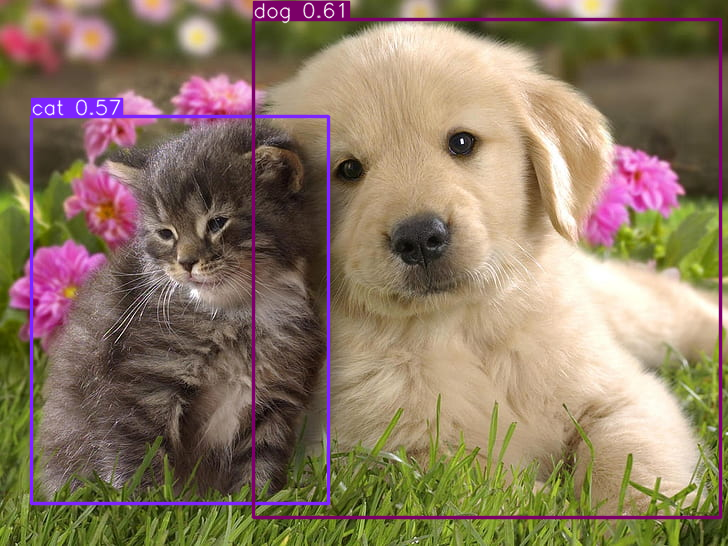

In [18]:
# Perform inference on the image
results = model("/content/image_name.jpg")

# Print detection results for the first item in the list (index 0)
# Accessing the boxes attribute and printing its representation
print(results[0].boxes)  # Display detection boxes

# Visualize results on the image for the first item
results[0].show()

2. How do you load the Faster RCNN model with a ResNet50 backbone and print its architecture?


In [21]:
pip install torch torchvision torchsummary


In [31]:
import torchvision
import torch

def load_faster_rcnn_resnet50():
    # Load pre-trained Faster R-CNN model with ResNet50 backbone
    # We'll use the pre-trained weights on COCO dataset
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

    # Set the model to evaluation mode
    model.eval()

    # Print the model architecture
    print(model)

    return model

# Example usage
if __name__ == '__main__':
    # Load and print the model architecture
    faster_rcnn_model = load_faster_rcnn_resnet50()

    # Optionally, print total number of parameters
    total_params = sum(p.numel() for p in faster_rcnn_model.parameters())
    print(f"\nTotal number of parameters: {total_params:,}")

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

3. How do you perform inference on an online image using the Faster RCNN model and print the predictions?


{'boxes': tensor([[ 66.4010,  13.9458, 237.4546, 180.5452],
        [233.6962,  73.0942, 255.0457,  97.4296],
        [ 38.7058,  50.5495, 104.6925, 178.8270],
        [ 77.9289,  87.9395, 204.4519, 181.9688],
        [ 42.3892,  52.5441, 168.7655, 183.0000],
        [ 33.2088, 160.9829,  45.7487, 183.0000],
        [ 16.5640,  76.4551,  28.2505,  97.1754],
        [ 16.2639,  75.1023,  28.1028,  97.0432],
        [  1.3275, 101.9253,  54.6933, 173.2893],
        [ 63.1689,  16.6023, 134.2416, 138.6314],
        [ 66.5601,  16.3412, 126.7790,  58.8667],
        [ 60.9563,  17.6853, 147.3499, 138.9655],
        [ 61.8190,  18.4172, 148.3776, 140.3585],
        [ 34.1978,  24.1522, 178.0845, 183.0000],
        [242.8696, 116.8233, 271.5104, 178.9436],
        [ 95.3812,  98.5992, 192.3216, 179.7035],
        [ 60.8494,  15.6001, 177.4243, 171.1828],
        [ 18.0807,  80.5700,  24.7633,  96.7200],
        [137.0877,  18.0214, 230.2854, 153.4457],
        [ 90.0093,  23.5282, 133.7903,  

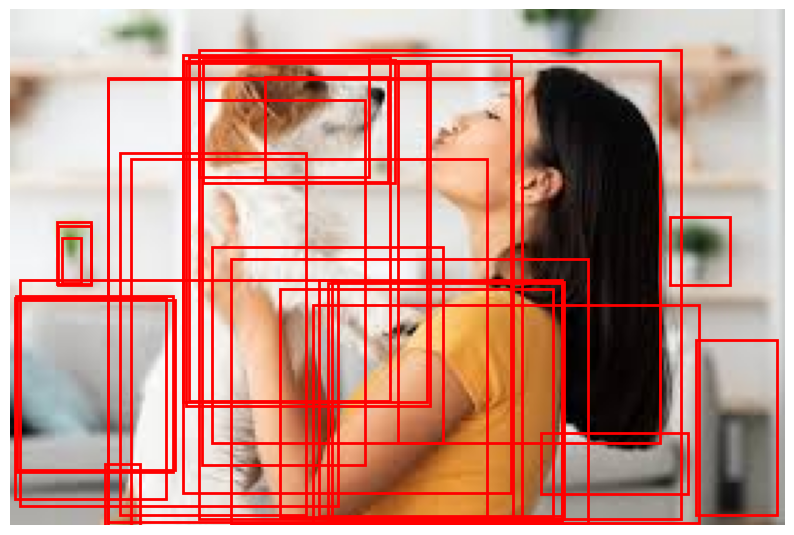

In [32]:
import torch
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Load the pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Download the image from an online URL
image_url = "https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcRmgvxg8JmYwDDI0RGQJ6FZslZUCvEsridzCQ&s"
response = requests.get(image_url)
img = Image.open(BytesIO(response.content)).convert("RGB")

# Transform the image to the format the model expects
transform = torchvision.transforms.Compose([
    torchvision.transforms.ToTensor(),
])
img_tensor = transform(img).unsqueeze(0)

# Perform inference
with torch.no_grad():
    predictions = model(img_tensor)

# Print the predictions
for element in predictions:
    print(element)

# Visualize the results (optional)
def visualize_predictions(img, predictions):
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    ax = plt.gca()

    for box in predictions[0]['boxes']:
        rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                 linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

    plt.axis('off')
    plt.show()

visualize_predictions(img, predictions)


4. How do you load an image and perform inference using YOLOV9, then display the detected objects with bounding boxes and class labels?


In [111]:
!pip install opencv-python-headless


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-12-2 Python-3.10.12 torch-2.5.1+cu121 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
image 1/1: 546x728 1 bear
Speed: 12.7ms pre-process, 599.8ms inference, 2.1ms NMS per image at shape (1, 3, 480, 640)


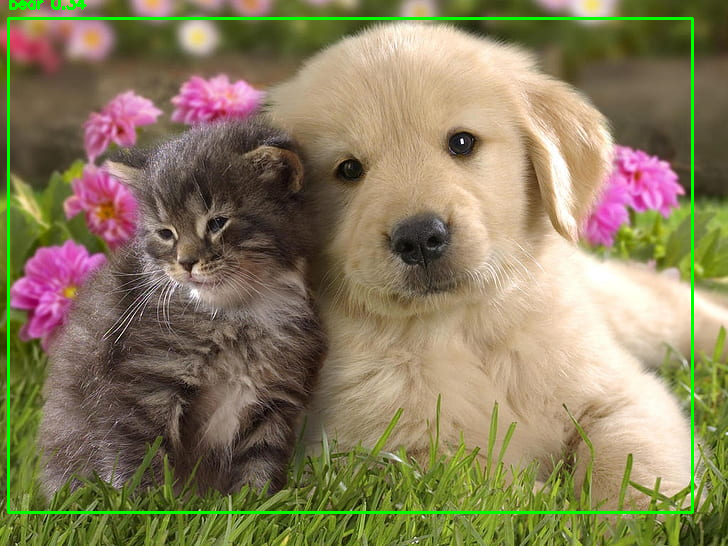

In [113]:
!pip install opencv-python-headless

import torch
import cv2
from google.colab.patches import cv2_imshow  # Import cv2_imshow

# Load the YOLOv9 model (replace 'yolov5' with 'yolov9' if you have the specific YOLOv9 implementation)
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)  # Use yolov8 or yolov9 as needed

# Load the image
image_path = '/content/image_name.jpg'  # Replace with your image path
image = cv2.imread(image_path)

# Perform inference
results = model(image)

# Print results (optional)
results.print()  # This will show detected objects and their confidence scores

# Get bounding box coordinates and class labels
boxes = results.xyxy[0]  # Get detections for the first image in batch

for box in boxes:
    x1, y1, x2, y2, conf, cls = box  # unpacking values
    label = f"{model.names[int(cls)]} {conf:.2f}"  # Class name and confidence score

    # Draw bounding box and label on the image
    cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)  # Green box
    cv2.putText(image, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display the output image with bounding boxes using cv2_imshow
cv2_imshow(image) # Use cv2_imshow instead of cv2.imshow
#cv2.waitKey(0) # These lines are not needed in Colab
#cv2.destroyAllWindows()

5. How do you display bounding boxes for the detected objects in an image using Faster RCNN?


In [37]:
import torch
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Load the pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Download the image from an online URL
image_url = "https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTL_-NwEbnOlVJumYt3D8NK4vckPa4ywfsKTQ&s"
response = requests.get(image_url)
img = Image.open(BytesIO(response.content)).convert("RGB")

# Transform the image to the format the model expects
transform = torchvision.transforms.Compose([
    torchvision.transforms.ToTensor(),
])
img_tensor = transform(img).unsqueeze(0)

# Perform inference
with torch.no_grad():
    predictions = model(img_tensor)

# Print the predictions
print(predictions)


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


[{'boxes': tensor([[ 79.7378,  68.7146, 190.8850, 130.0738],
        [ 32.4060,  98.0805,  83.6019, 122.5209],
        [  0.6414,  98.1477,  68.1931, 117.1073],
        [202.5429, 102.2911, 212.1520, 121.1618],
        [  0.0000, 106.5188,  66.5411, 126.1496],
        [  0.0000, 109.9486,  71.7328, 186.9417],
        [  0.0000, 104.4991,  70.2631, 148.2638],
        [  6.6742,  96.6498, 259.0000, 192.4505],
        [  0.0000,  21.2439, 259.0000, 180.6950],
        [170.6901,  25.9920, 178.0264,  54.4617],
        [  0.4845,  96.9091,  48.2736, 109.5295],
        [  0.0000, 102.3084,  50.4515, 113.3222],
        [  0.0000, 106.6644,  53.3833, 116.1294],
        [  4.7610, 110.9558, 128.6441, 192.5819],
        [ 73.2689, 132.4655, 258.0119, 192.0730],
        [167.8937,  20.8666, 173.4454,  54.0260],
        [170.0421,  26.7273, 173.7616,  54.0560],
        [ 75.1175, 132.1565, 257.7307, 192.0764],
        [ 15.8002, 123.8250, 256.9111, 194.0000],
        [171.9501,  25.5294, 175.0536, 

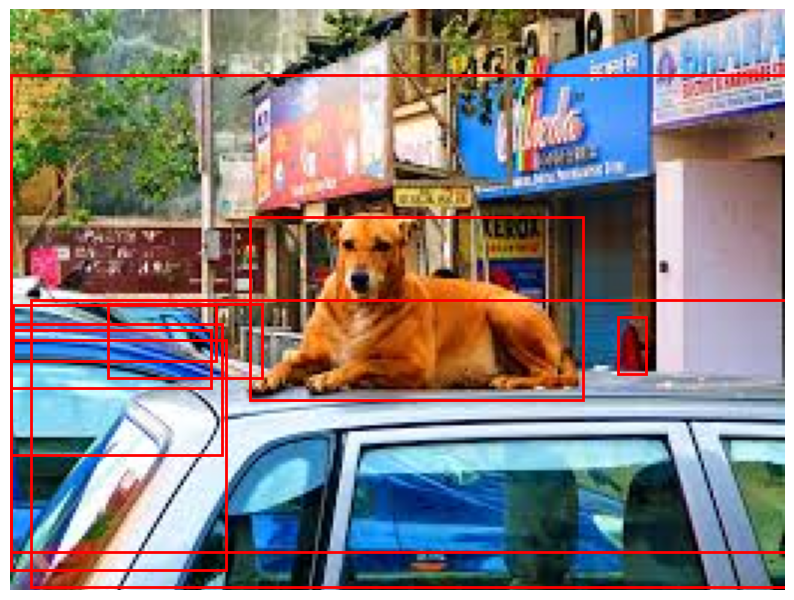

In [38]:
# Function to visualize predictions
def visualize_predictions(img, predictions, threshold=0.5):
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    ax = plt.gca()

    for element in predictions:
        boxes = element['boxes']
        scores = element['scores']

        for i in range(len(boxes)):
            if scores[i] > threshold:
                box = boxes[i]
                rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                         linewidth=2, edgecolor='r', facecolor='none')
                ax.add_patch(rect)

    plt.axis('off')
    plt.show()

# Visualize the results
visualize_predictions(img, predictions)


6. How do you perform inference on a local image using Faster RCNN?


In [40]:
from google.colab import files as FILE
import requests
import os
DownURL = "https://upload.wikimedia.org/wikipedia/commons/thumb/0/0f/Grosser_Panda.JPG/640px-Grosser_Panda.JPG"
img_data = requests.get(DownURL).content
with open('panda.jpg', 'wb') as handler:
    handler.write(img_data)

FILE.download('panda.jpg')
#os.remove('image_name.jpg')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [41]:
import torch
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Load the pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Load the local image
image_path = "/content/panda.jpg"
img = Image.open(image_path).convert("RGB")

# Transform the image to the format the model expects
transform = torchvision.transforms.Compose([
    torchvision.transforms.ToTensor(),
])
img_tensor = transform(img).unsqueeze(0)

# Perform inference
with torch.no_grad():
    predictions = model(img_tensor)

# Print the predictions
print(predictions)


[{'boxes': tensor([[187.7933,  32.0652, 449.9259, 363.1199],
        [  6.2752,  71.4643, 178.2086, 392.5312],
        [  1.9889, 187.7264, 240.4626, 421.7356]]), 'labels': tensor([23, 64, 64]), 'scores': tensor([0.9975, 0.4835, 0.1527])}]


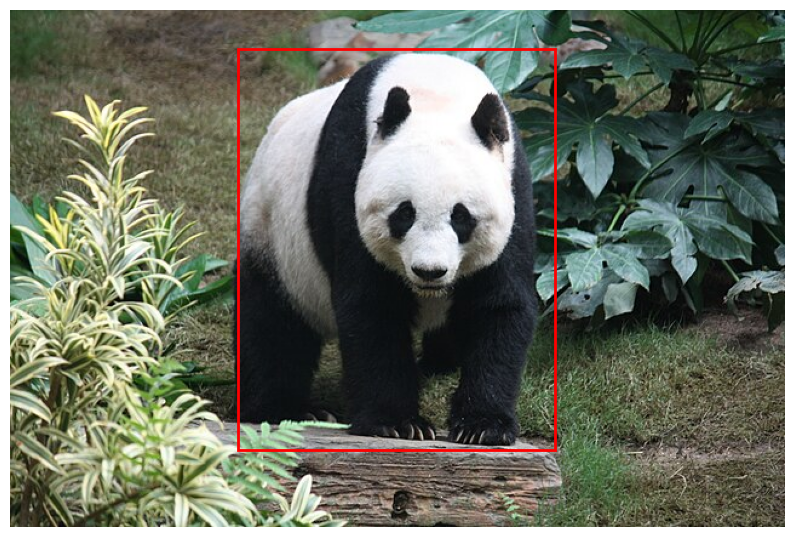

In [42]:
# Function to visualize predictions
def visualize_predictions(img, predictions, threshold=0.5):
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    ax = plt.gca()

    for element in predictions:
        boxes = element['boxes']
        scores = element['scores']

        for i in range(len(boxes)):
            if scores[i] > threshold:
                box = boxes[i]
                rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                         linewidth=2, edgecolor='r', facecolor='none')
                ax.add_patch(rect)

    plt.axis('off')
    plt.show()

# Visualize the results
visualize_predictions(img, predictions)


7. How can you change the confidence threshold for YOLO object detection and filter out low-confidence predictions?


In [46]:
!pip install torch torchvision pillow yolov5



In [50]:
DownURL = "https://images.cnbctv18.com/wp-content/uploads/2023/09/red-panda.jpg?impolicy=website&width=1200&height=900"


img_data = requests.get(DownURL).content
with open('redpanda.jpg', 'wb') as handler:
    handler.write(img_data)

FILE.download('redpanda.jpg')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-12-2 Python-3.10.12 torch-2.5.1+cu121 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


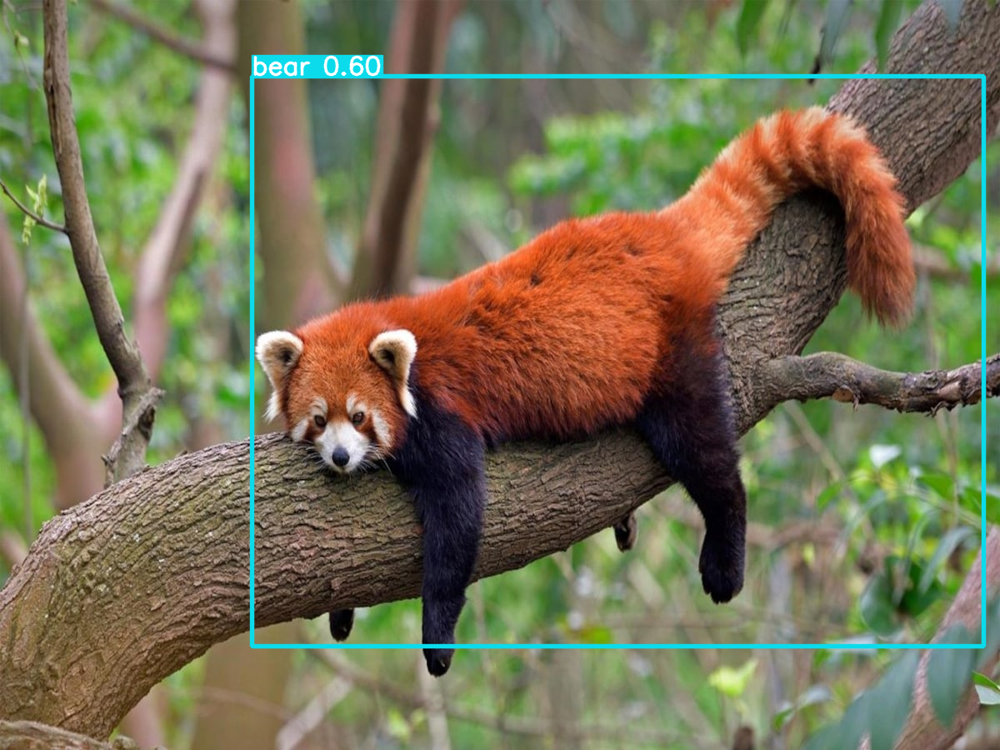

In [54]:
import torch
import cv2
import matplotlib.pyplot as plt

# Load the pre-trained YOLOv5 model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')  # 'yolov5s' is a smaller version of YOLOv5

# Define the custom confidence threshold
conf_threshold = 0.5  # You can change this value to adjust the confidence threshold (e.g., 0.5 = 50%)

# Perform inference
results = model('/content/redpanda.jpg')  # Pass the image path without the 'conf' argument

# Filter predictions based on confidence threshold (after inference)
predictions = results.pred[0]  # Get predictions for the first image
high_confidence_predictions = predictions[predictions[:, 4] > conf_threshold]  # Filter by confidence > 0.5

# Show filtered results (detections with high confidence)
results.show()

# Load the image using OpenCV
image = cv2.imread('/content/redpanda.jpg')

# Check if the image is loaded properly
if image is None:
    print("Error loading image")
else:
    # Iterate over the high-confidence predictions
    for pred in high_confidence_predictions:
        x1, y1, x2, y2 = map(int, pred[:4])  # Get bounding box coordinates (x1, y1, x2, y2)
        confidence = pred[4]  # Confidence score
        label = int(pred[5])  # Class label (e.g., person, car, etc.)

        # Draw the bounding box on the image
        cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)

        # Put the label and confidence score on the image
        label_text = f'Class: {label}, Confidence: {confidence:.2f}'
        cv2.putText(image, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    # Convert the image from BGR to RGB for display (only if image was loaded successfully)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Show the image using matplotlib
    plt.imshow(image_rgb)
    plt.axis('off')  # Hide axis
    plt.show()


8. How do you plot the training and validation loss curves for model evaluation?


In [85]:
DownURL = "https://www.google.com/url?q=https%3A%2F%2Fupload.wikimedia.org%2Fwikipedia%2Fcommons%2F7%2F75%2FMonkey_in_the_jungle.jpg"
img_data = requests.get(DownURL).content
with open('monkey.jpg', 'wb') as handler:
    handler.write(img_data)

FILE.download('monkey.jpg')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [58]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.model_selection import train_test_split

# Example: Create custom data
# Assume 1000 samples with 10 features each for simplicity
X = np.random.rand(1000, 10)  # 1000 samples, 10 features
y = np.random.randint(0, 2, 1000)  # Binary labels (0 or 1)

# Split data into training and validation sets (80% train, 20% validation)
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# Define a simple model
model = tf.keras.Sequential([
    tf.keras.layers.Dense(64, activation='relu', input_dim=X_train.shape[1]),
    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid')  # For binary classification
])

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model and track history (loss and val_loss)
history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=10, batch_size=32)

# Extract the training and validation losses
train_loss = history.history['loss']
val_loss = history.history['val_loss']

# Plotting the Training and Validation Loss Curves
plt.plot(range(1, len(train_loss) + 1), train_loss, label='Training Loss')
plt.plot(range(1, len(val_loss) + 1), val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


Epoch 1/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.5477 - loss: 0.6936 - val_accuracy: 0.5200 - val_loss: 0.6929
Epoch 2/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5216 - loss: 0.6923 - val_accuracy: 0.5150 - val_loss: 0.6927
Epoch 3/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5083 - loss: 0.6940 - val_accuracy: 0.4850 - val_loss: 0.6953
Epoch 4/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5372 - loss: 0.6903 - val_accuracy: 0.5050 - val_loss: 0.6949
Epoch 5/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5295 - loss: 0.6923 - val_accuracy: 0.5250 - val_loss: 0.6944
Epoch 6/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5428 - loss: 0.6886 - val_accuracy: 0.5000 - val_loss: 0.6933
Epoch 7/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.5491 - loss: 0.6885 - val_accuracy: 0.5200 - val_loss: 0.6948
Epoch 8/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.5667 - loss: 0.6864 - val_accuracy: 0.5000 - val_loss

9. How do you perform inference on multiple images from a local folder using Faster RCNN and display the bounding boxes for each?


In [65]:
pip install torch torchvision opencv-python matplotlib

In [67]:
import torch
import torchvision.transforms as transforms
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

In [68]:
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [69]:
transform = transforms.Compose([
    transforms.ToTensor(),
])

In [83]:
import torch
import torchvision.transforms as transforms
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
# Enable inline plotting in Colab
%matplotlib inline

def infer_and_display(image_path):
    # Load and transform the image
    image = cv2.imread(image_path)

    # Check if the image was loaded successfully
    if image is None:
        print(f"Error: Could not load image at path: {image_path}")
        return  # Exit the function if image loading failed

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_tensor = transform(image_rgb).unsqueeze(0)  # Add batch dimension

    # Perform inference
    with torch.no_grad():
        predictions = model(image_tensor)

    # Extract bounding boxes and scores
    boxes = predictions[0]['boxes'].numpy()
    scores = predictions[0]['scores'].numpy()

    # Set a threshold for displaying boxes
    threshold = 0.5
    for box, score in zip(boxes, scores):
        if score > threshold:
            x1, y1, x2, y2 = box.astype(int)
            cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (255, 0, 0), 2)
            cv2.putText(image_rgb, f'{score:.2f}', (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    # Display the image with bounding boxes
    plt.figure(figsize=(12, 12))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

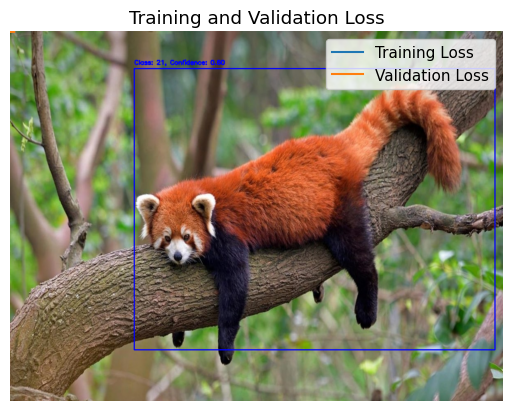

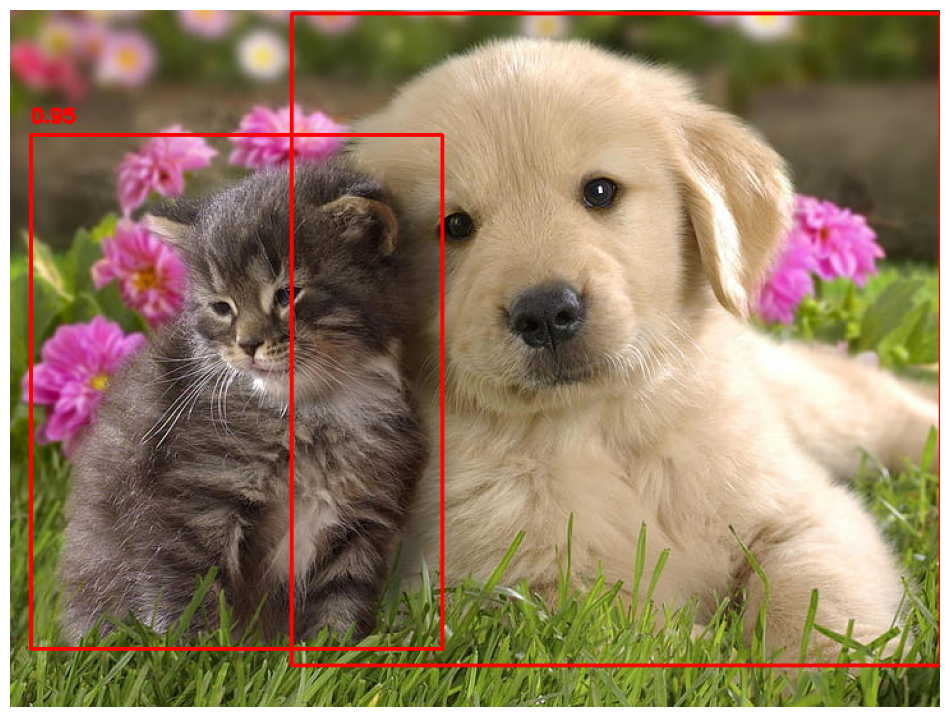

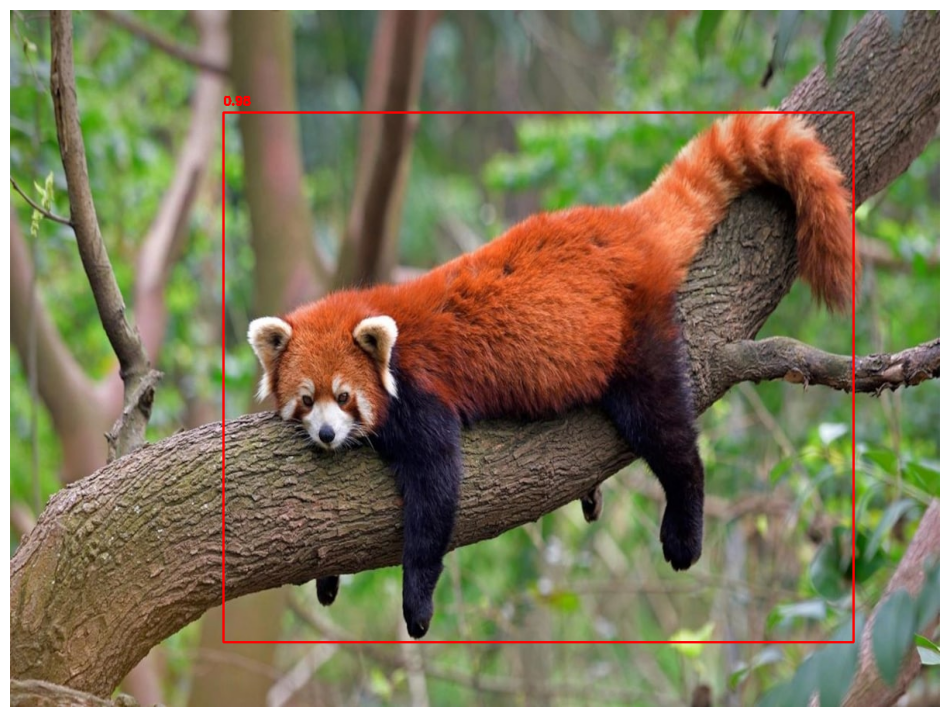

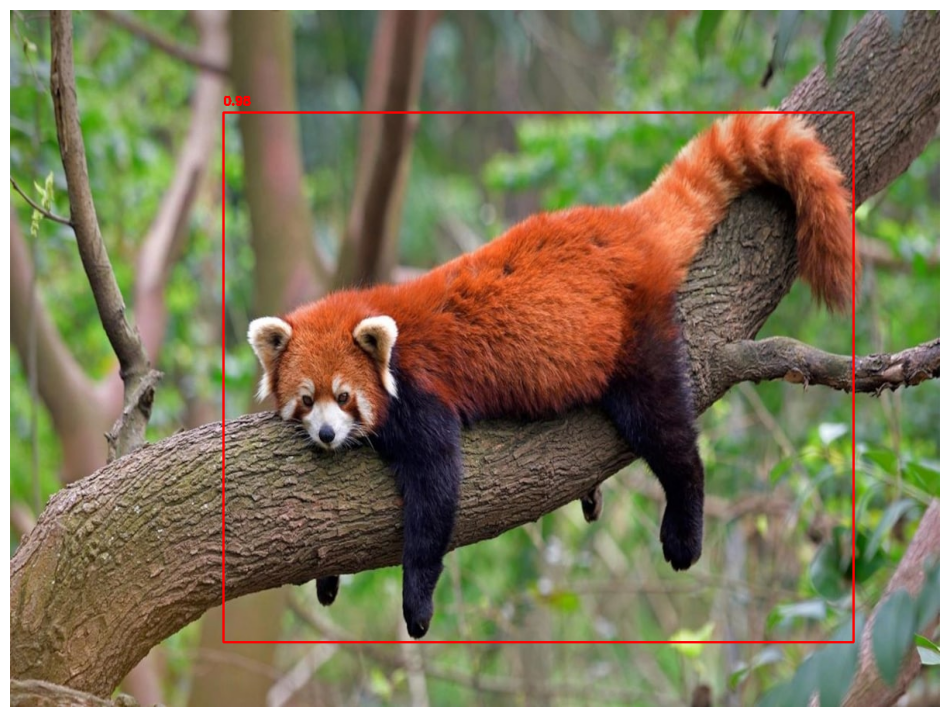

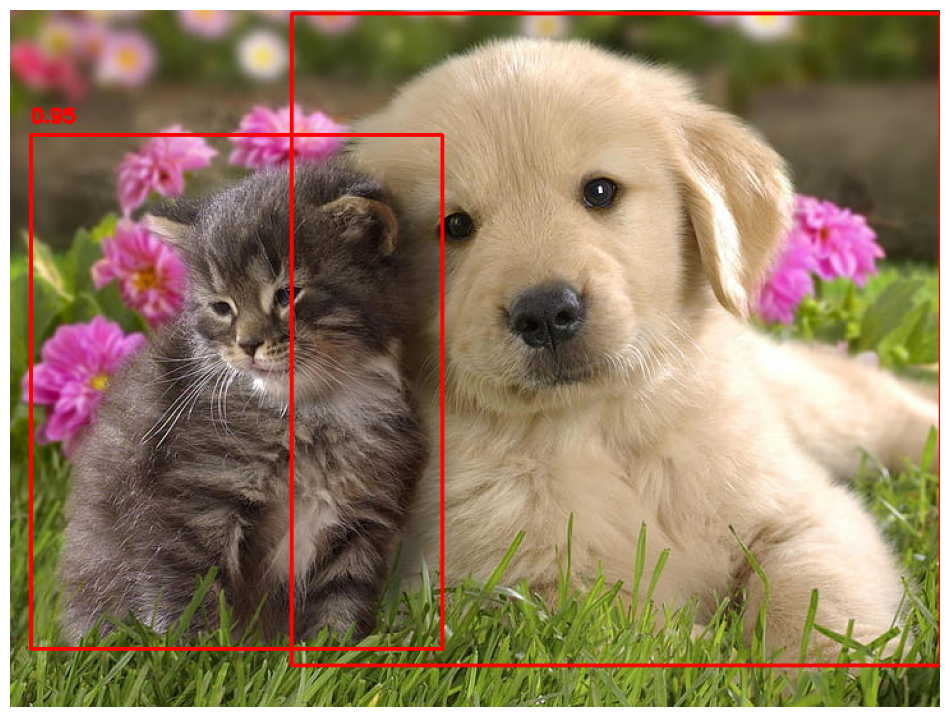

...

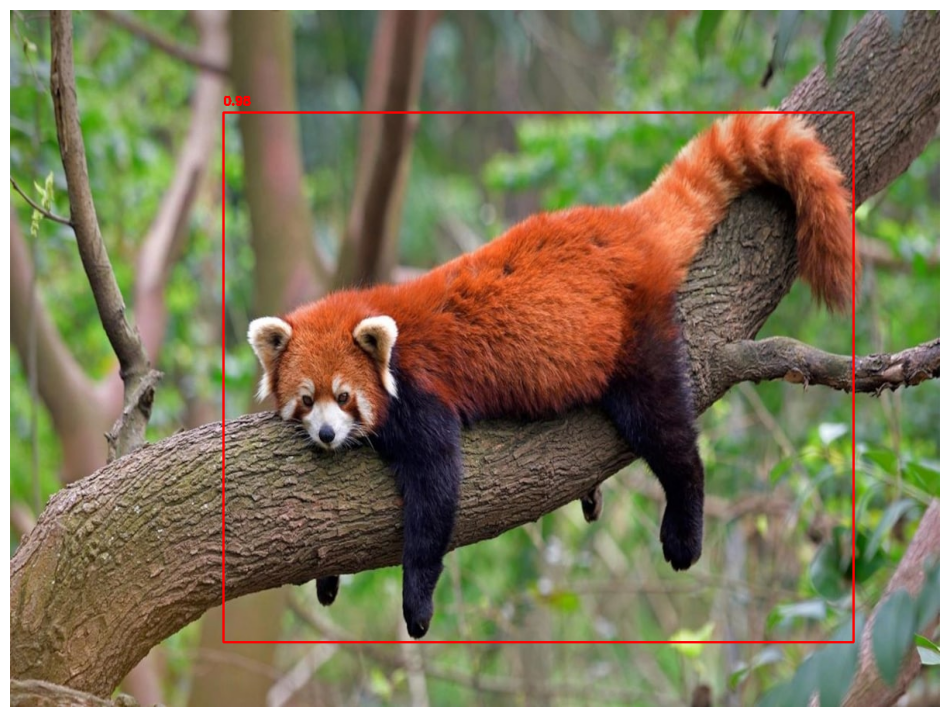

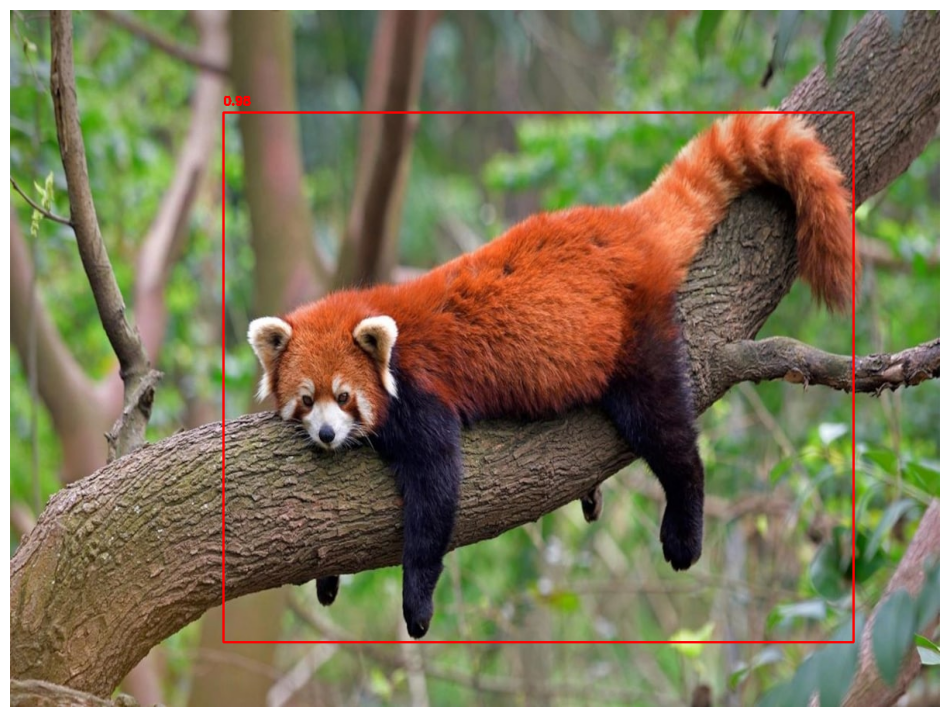

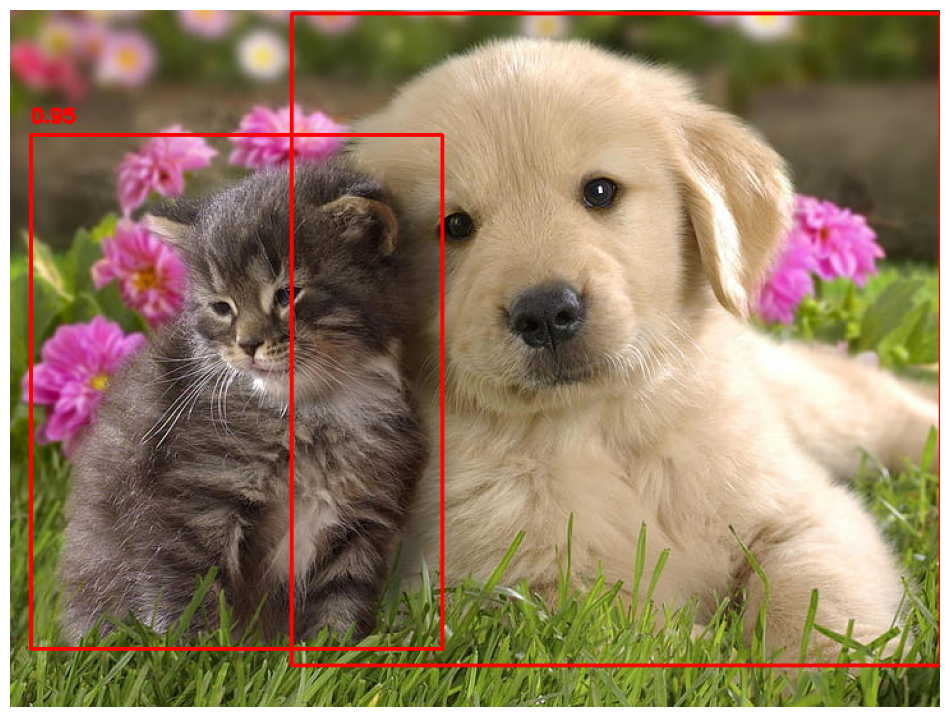

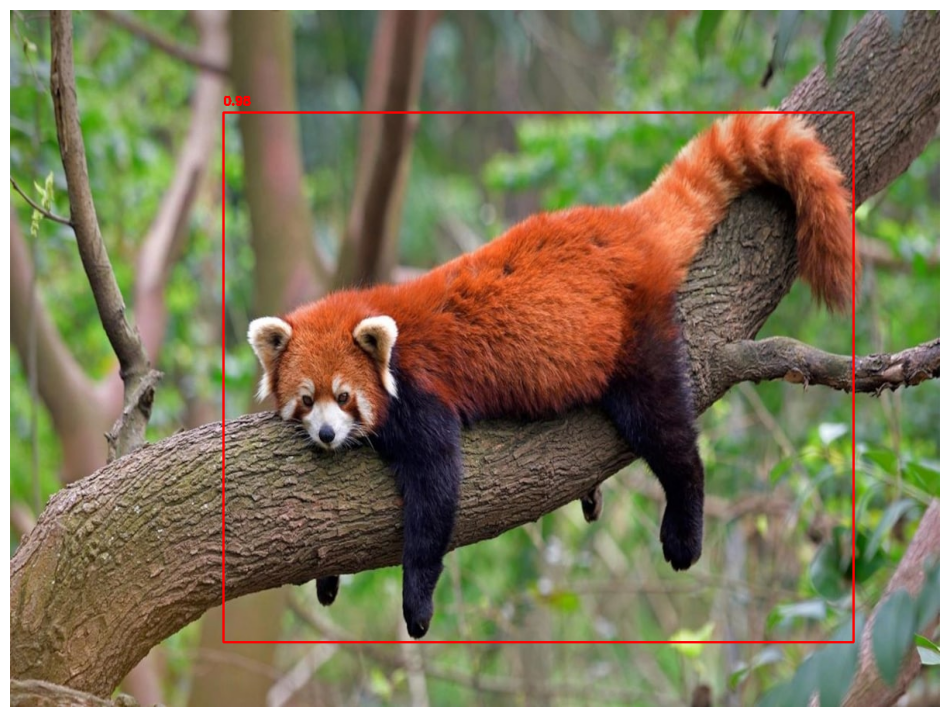

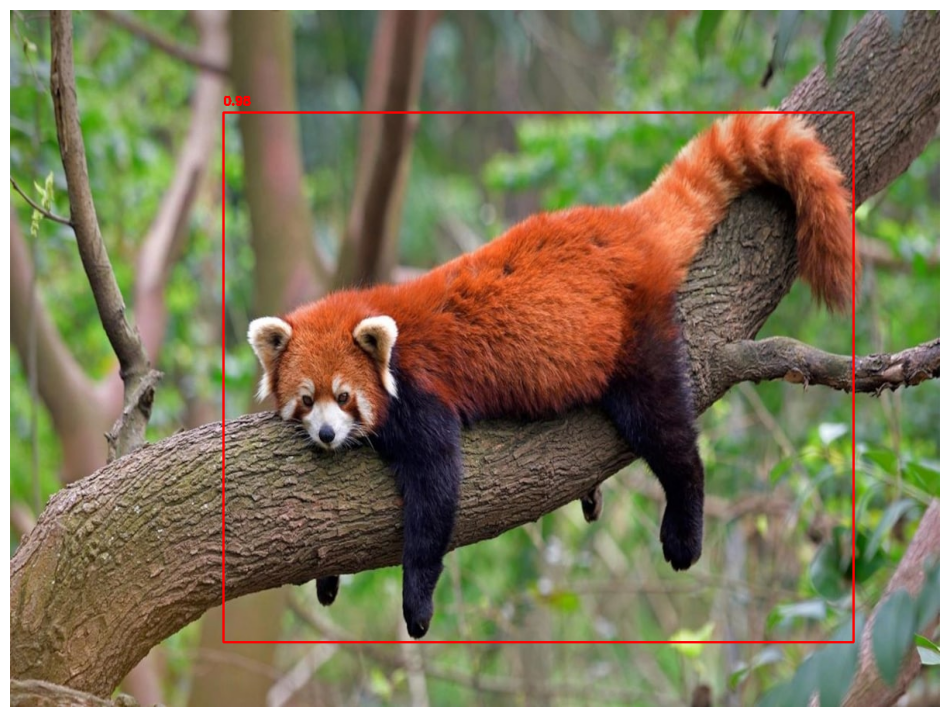

In [84]:
folder_path = '/content'
for filename in os.listdir(folder_path):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
        full_path = os.path.join(folder_path, filename)
        infer_and_display(full_path)

10. How do you visualize the confidence scores alongside the bounding boxes for detected objects using Faster RCNN?


In [98]:
from google.colab import files as FILE
import requests
import os
DownURL = "https://i.ytimg.com/vi/X90n1bT1a1E/maxresdefault.jpg"
img_data = requests.get(DownURL).content
with open('monkey.jpg', 'wb') as handler:
    handler.write(img_data)

FILE.download('monkey.jpg')
#os.remove('image_name.jpg')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Detections found.


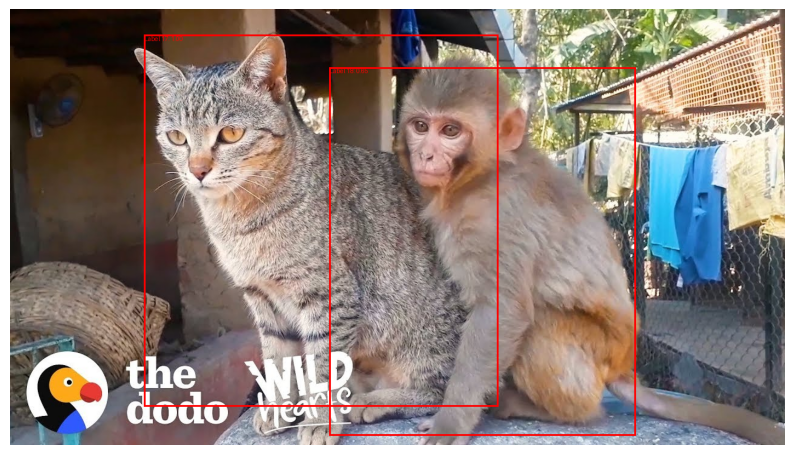

In [99]:
import torch
from torchvision import models, transforms
from PIL import Image, ImageDraw
import numpy as np
import matplotlib.pyplot as plt

# Load pre-trained Faster R-CNN model
model = models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Define the transform to apply to the input image
transform = transforms.Compose([
    transforms.ToTensor(),
])

# Load an image
image_path = '/content/monkey.jpg'
image = Image.open(image_path).convert("RGB")

# Transform the image
input_tensor = transform(image)
input_batch = input_tensor.unsqueeze(0)  # Create a batch

# Check if a GPU is available, if not, use CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
input_batch = input_batch.to(device)

# Run Faster R-CNN to get detections
with torch.no_grad():
    predictions = model(input_batch)

# Extract the bounding boxes, labels, and scores
boxes = predictions[0]['boxes']
labels = predictions[0]['labels']
scores = predictions[0]['scores']

# Set a confidence threshold
confidence_threshold = 0.5

# Convert the image to a format that can be drawn on
draw = ImageDraw.Draw(image)

# Loop through each detection and draw boxes and labels if the confidence score is above the threshold
for i in range(len(boxes)):
    score = scores[i].item()
    if score > confidence_threshold:
        box = boxes[i].cpu().numpy()
        label = labels[i].item()

        # Draw the bounding box (left, top, right, bottom)
        draw.rectangle([(box[0], box[1]), (box[2], box[3])], outline="red", width=3)

        # Label the box with the confidence score
        label_text = f"Label {label}: {score:.2f}"
        draw.text((box[0], box[1]), label_text, fill="red")

# Check if there are any detections
if len(scores) == 0:
    print("No detections found.")
else:
    print("Detections found.")

# If you're in a Jupyter Notebook, display using matplotlib
plt.figure(figsize=(10, 10))
plt.imshow(np.array(image))
plt.axis('off')
plt.show()

# Alternatively, save the image to check manually
image.save('output_image.jpg')


11. How can you save the inference results (with bounding boxes) as a new image after performing detection using YOLO?

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2024-12-2 Python-3.10.12 torch-2.5.1+cu121 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:892: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


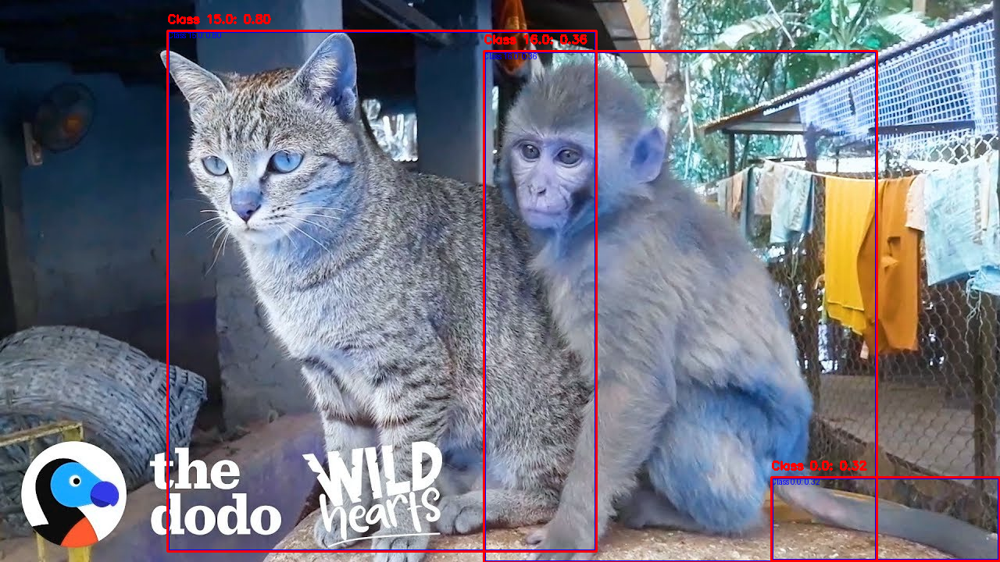

Inference results saved as images.


In [106]:
import torch
import cv2
from PIL import Image, ImageDraw
import numpy as np
from google.colab.patches import cv2_imshow  # For displaying images in Colab

# Step 1: Load pre-trained YOLOv5 model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')  # Use 'yolov5s', 'yolov5m', or 'yolov5l' based on your needs

# Step 2: Load the image
image_path = '/content/monkey.jpg'  # Specify your image path here
image = Image.open(image_path)

# Step 3: Perform detection
results = model(image)

# Step 4: Extract bounding boxes, labels, and confidence scores
pred = results.pred[0]  # This is a tensor with detections (x1, y1, x2, y2, confidence, class)
boxes = pred[:, :-2]  # Extract the bounding boxes
scores = pred[:, -2]  # Confidence scores
labels = pred[:, -1]  # Class labels

# Step 5: Create a PIL ImageDraw object to draw on the image
draw = ImageDraw.Draw(image)

# Step 6: Loop over each detection and draw bounding boxes with confidence scores
for i in range(len(boxes)):
    x1, y1, x2, y2 = boxes[i].tolist()  # Get bounding box coordinates
    score = scores[i].item()  # Get confidence score
    label = labels[i].item()  # Get class label

    # Draw the bounding box (red color with width 3)
    draw.rectangle([x1, y1, x2, y2], outline="red", width=3)

    # Add label and confidence score text to the image
    label_text = f"Class {label}: {score:.2f}"
    draw.text((x1, y1), label_text, fill="red")

# Step 7: Save the resulting image with bounding boxes as a new image
output_image_path = 'output_image_with_bboxes.jpg'  # Path to save the new image
image.save(output_image_path)

# Step 8: Optionally, display the image using PIL's show method
image.show()

# If you want to display and save the image using OpenCV, convert the PIL image to a numpy array
image_cv = np.array(image)

# Loop over each detection and draw bounding boxes (using OpenCV)
for i in range(len(boxes)):
    x1, y1, x2, y2 = boxes[i].tolist()  # Get bounding box coordinates
    score = scores[i].item()  # Confidence score
    label = labels[i].item()  # Class label

    # Draw bounding box (OpenCV format: BGR)
    cv2.rectangle(image_cv, (int(x1), int(y1)), (int(x2), int(y2)), (0, 0, 255), 2)

    # Add label text (confidence score)
    label_text = f"Class {label}: {score:.2f}"
    cv2.putText(image_cv, label_text, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

# Step 9: Save the result using OpenCV
output_image_path_cv = 'output_image_with_boxes_cv.jpg'  # Path to save the new image
cv2.imwrite(output_image_path_cv, image_cv)

# Step 10: Optionally display the image using OpenCV (using cv2_imshow in Colab)
cv2_imshow(image_cv)

print("Inference results saved as images.")
